In [1]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
import scipy.linalg as linalg
from math import pi,sin,cos,exp,sqrt
from IPython.display import display, clear_output,HTML

In [2]:
#差分法計算部分
def Calculation1moment(ρ_1,ρ_2,N,h,τ,η,λ,ρm,u):
    ρ_1past=ρ_1.copy()
    ρ_1=np.zeros(N+2)
    ρ_2past=ρ_2.copy()
    ρ_2=np.zeros(N+2)
    
    #微分項
    ρ_1[1:N+1]=(ρ_1past[1:N+1]
                -τ*u*( (ρ_1past[1:N+1] - ρ_1past[1:N+1]*ρ_1past[1:N+1]/ρm - ρ_1past[1:N+1]*ρ_2past[1:N+1]/ρm)
                     -(ρ_1past[:N]  - ρ_1past[:N]*ρ_1past[:N]/ρm       -  ρ_1past[:N]*ρ_2past[:N]/ρm) )/h
                +0.5*η*λ*(ρ_1past[2:]*ρ_1past[2:] - 2*ρ_1past[1:N+1]*ρ_1past[1:N+1] + ρ_1past[:N]*ρ_1past[:N]))
                
    ρ_2[1:N+1]=(ρ_2past[1:N+1]
                +τ*u*( (ρ_2past[2:] - ρ_2past[2:]*ρ_2past[2:]/ρm       - ρ_1past[2:]*ρ_2past[2:]/ρm)
                   -(ρ_2past[1:N+1] - ρ_2past[1:N+1]*ρ_2past[1:N+1]/ρm - ρ_1past[1:N+1]*ρ_2past[1:N+1]/ρm) )/h
                +0.5*η*λ*(ρ_2past[2:]*ρ_2past[2:] - 2*ρ_2past[1:N+1]*ρ_2past[1:N+1] + ρ_2past[:N]*ρ_2past[:N]))
    #相互作用
    R=(ρ_1past[1:N+1]-ρ_2past[1:N+1])/(ρ_1past[1:N+1]+ρ_2past[1:N+1])
            
    relativeV=(2*u*(np.ones(N)-(ρ_1past[1:N+1]+ρ_2past[1:N+1])/ρm)+
               0.5*η*(-ρ_1past[2:]+ρ_1past[:N]+ρ_2past[2:]-ρ_2past[:N])/h)
    #pの値、論文ママ
    p=np.ones(N) - (ρ_1past[1:N+1]+ρ_2past[1:N+1])/ρm
    
    ρ_1[1:N+1]+=τ*(R*ρ_1past[1:N+1]*ρ_2past[1:N+1]*(np.ones(N) - p)*relativeV)
    ρ_2[1:N+1]-=τ*(R*ρ_1past[1:N+1]*ρ_2past[1:N+1]*(np.ones(N) - p)*relativeV)

    ρ_1[N+1],ρ_1[0]=ρ_1[1],ρ_1[N]
    ρ_2[N+1],ρ_2[0]=ρ_2[1],ρ_2[N]
    return ρ_1,ρ_2

In [3]:
#計算量(N*n)
def a(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=0.12*(1+sin(2*pi*x))
    u[N+1]=u[0]
    return u
def b(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=0.12*(1+cos(2*pi*x))
    u[N+1]=u[0]
    return u


def PedestrainFlow(h,τ,N,n,ρm,η,u):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.set_xlim(0,h*(N+1))
    ax.set_ylim(0,τ*(n+1))
    ax.set_zlim(0,ρm)
    xs=np.array([h*i for i in range(N+2)])

    ρ_1=a(N,h)
    ρ_2=b(N,h)
    λ=τ/(h*h)
    interval=n//100
    print("λ="+str(λ))
    print("安定性条件1:  "+str(1/(η*ρm))+"=1/ρmη > λ="+str(λ))
    print("安定性条件2:  "+str(ρm*η/(2*u))+"=ρmη/2u > h="+str(h))
    
    ax.plot(xs,np.zeros(N+2), ρ_1,color="b", alpha = 0.3)
    ax.plot(xs,np.zeros(N+2), ρ_2,color="r", alpha = 0.3)

    for i in range(1,n+1):
        ρ_1,ρ_2=Calculation1moment(ρ_1,ρ_2,N,h,τ,η,λ,ρm,u)
        
        if i%interval==0:
            ax.plot(xs, np.full(N+2,i*τ), ρ_1,color="b", alpha = 0.3)
            ax.plot(xs, np.full(N+2,i*τ), ρ_2,color="r", alpha = 0.3)    
    return

λ=0.9999999999999998
安定性条件1:  25.0=1/ρmη > λ=0.9999999999999998
安定性条件2:  0.04=ρmη/2u > h=0.05


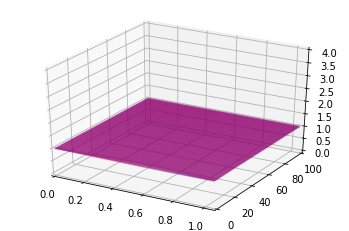

In [55]:

def a(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=(1+0.01*sin(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
def b(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=(1+0.01*cos(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
#(h,τ,N,n,ρm,η,u)
PedestrainFlow(1/20,1/400,20,40000,4,0.01,0.5)

In [4]:
def a(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=0.12*(1+sin(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
def b(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=0.12*(1+cos(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u

def PedestrainFlowAnimation(h,τ,N,n,ρm,η,u,interval):
    fig, ax = plt.subplots()
    ax.set_xlim(0,h*(N+1))
    ax.set_ylim(-0.1,ρm)
    xs=np.array([h*i for i in range(N+2)])

    ρ_1=a(N,h)
    ρ_2=b(N,h)
    ρmi=1/ρm
    λ=τ/(h*h)
    print("安定性条件1:  "+str(ρmi/η)+"=1/ρmη > λ="+str(λ))
    print("安定性条件2:  "+str(ρm*η/(2*u))+"=ρmη/2u > h="+str(h))
    print(sum(ρ_1[1:N+1])+sum(ρ_2[1:N+1]))
    
    im1=plt.plot(xs, ρ_1,color="b")
    im2=plt.plot(xs, ρ_2,color="r")
    ims=[im1+im2+[plt.text(1.06, 0, 't='+str(0)[:4])]]

    for i in range(1,n+1):
        ρ_1,ρ_2=Calculation1moment(ρ_1,ρ_2,N,h,τ,η,λ,ρm,u)
        
        if i%interval==0:
            im1=plt.plot(xs, ρ_1,color="b")
            im2=plt.plot(xs, ρ_2,color="r")
            ims.append(im1+im2+[plt.text(1.06, 0, 't='+str(i*τ)[:4])])
    ani = animation.ArtistAnimation(fig,ims,interval=50)
    plt.close()
    print(sum(ρ_1[1:N+1])+sum(ρ_2[1:N+1]))
    return HTML(ani.to_jshtml())

In [9]:
def a(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=(1+0.01*sin(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
def b(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=(1+0.01*cos(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
#(h,τ,N,n,ρm,η,u,interval)
PedestrainFlowAnimation(1/30,1/9000,30,4500000,3,0.01,0.5,9000)

安定性条件1:  33.33333333333333=1/ρmη > λ=0.1
安定性条件2:  0.03=ρmη/2u > h=0.03333333333333333
60.0
60.00000000000169


In [44]:
def a(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=(1+0.1*sin(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
def b(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=(1+0.1*cos(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
PedestrainFlowAnimation(1/20,1/400,20,40000,5,0.01,0.5,1000)

安定性条件1:  20.0=1/ρmη > λ=0.9999999999999998
安定性条件2:  0.05=ρmη/2u > h=0.05
40.0
40.00000000000011


In [20]:
def a(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=(1+0.1*sin(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
def b(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=(1+0.1*cos(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
#(h,τ,N,n,ρm,η,u,interval)
PedestrainFlowAnimation(1/20,1/400,20,40000,4,0.01,0.5,1,100,0)

1/ρmη=25.0
λ=0.9999999999999998
ρmη/2u=0.04
40.0
40.00000000000001


In [46]:
#論文まま(h,τ,N,n,ρm,η,u,r,interval,save)
PedestrainFlowAnimation(1/1024,1/1024,1024,2**18,1,0.001,0.5,1,1000,0)

1/ρmη=1000.0
λ=1024.0
ρmη/2u=0.001
245.75999999999988
245.76


In [44]:
PedestrainFlowAnimation(1/1024,1/1024,1024,2**18,1,0.001,0.5,1,1000,0)

1/ρmη=1000.0
λ=1024.0
ρmη/2u=0.001
245.75999999999988
245.76000000000022


In [47]:
#τが大きいとダメ
def a(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=0.12*(1+sin(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
def b(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=0.12*(1+cos(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
PedestrainFlowAnimation(1/1024,1/512,1024,100,1,0.001,0.5,1)

安定性条件1:  1000.0=1/ρmη > λ=2048.0
安定性条件2:  0.001=ρmη/2u > h=0.0009765625
245.75999999999988


C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: divide by zero encountered in true_divide
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in multiply
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in multiply
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: RuntimeWarning: overflow encountered in multiply
  # Remove the CWD from sys.path while we load stuff.
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in subtract
  # Remove the CWD from sys.path while we load stuff.
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in multiply
  from ipykernel import kernelapp as app
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in subtr

nan


In [16]:
PedestrainFlowAnimation(1/1024,1/4096,1024,2**14,1,0.001,0.5,0,100,0)

1/ρmη=1000.0
λ=256.0
ρmη/2u=0.001
532.4799999999958
532.479999999996


In [48]:
#hが大きいとだめ
PedestrainFlowAnimation(1/256,1/1024,256,2500,1,0.001,0.5,50)

安定性条件1:  1000.0=1/ρmη > λ=64.0
安定性条件2:  0.001=ρmη/2u > h=0.00390625
61.440000000000005


C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: RuntimeWarning: divide by zero encountered in true_divide
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:24: RuntimeWarning: invalid value encountered in multiply
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in multiply
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: RuntimeWarning: overflow encountered in multiply
  # Remove the CWD from sys.path while we load stuff.
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in subtract
  # Remove the CWD from sys.path while we load stuff.
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in add
  # Remove the CWD from sys.path while we load stuff.
C:\Users\yusan\Anaconda3\lib\site-packages\ipykernel_launcher.py:15: RuntimeWarning: overflow encountered 

nan


In [60]:
def a(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=0.26*(1+sin(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
def b(N,h):
    u=np.ones(N+2)
    for i in range(N+1):
        x=h*i
        u[i]=0.26*(1+cos(2*pi*x))
    u[N+1]=u[1]
    u[0]=u[N]
    return u
def b(N,h):
    u=0.26*np.ones(N+2)
    return u
PedestrainFlowAnimation(1/256,1/2**12,256,2**16,1,0.05,0.5,1,500,0)

1/ρmη=20.0
λ=16.0
ρmη/2u=0.05
133.1199999999999
133.11999999999944


In [31]:
def a(N,h):
    u=0.28*np.ones(N+2)
    return u
def b(N,h):
    u=0.24*np.ones(N+2)
    return u
PedestrainFlowAnimation(1/512,1/2**14,512,2**16,1,0.05,0.5,1,100,0)

1/ρmη=20.0
λ=16.0


In [8]:
def Calculation(ρ_1,ρ_2,u_1,u_2,N,h,τ,a,η,λ,ρ_hs,u_hs,ρmi):
    ρ_1past=ρ_1.copy()
    ρ_1=np.zeros(N+2)
    ρ_2past=ρ_2.copy()
    ρ_2=np.zeros(N+2)
    u_1past=u_1.copy()
    u_1=np.zeros(N+2)
    u_2past=u_2.copy()
    u_2=np.zeros(N+2)

    R=(ρ_1past[1:N+1]-ρ_2past[1:N+1])/(ρ_1past[1:N+1]+ρ_2past[1:N+1])
    p=np.ones(N)-ρmi*(ρ_1past[1:N+1]+ρ_2past[1:N+1])
    α=np.ones(N+2)
    α[1:N+1]=ρ_hs*u_hs*ρmi*(ρ_1past[1:N+1]+ρ_2past[1:N+1])/a
    α[N+1],α[0]=α[1],α[N]

    """


    ρ_1[1:N+1]=(ρ_1past[1:N+1]-
                λ*h*(ρ_1past[1:N+1]*(u_1past[1:N+1]-u_1past[:N])+
                    u_1past[1:N+1]*(ρ_1past[2:]-ρ_1past[1:N+1]))
               )
    ρ_2[1:N+1]=(ρ_2past[1:N+1]-
                λ*h*(ρ_2past[1:N+1]*(u_2past[2:]-u_2past[1:N+1])+
                    u_2past[1:N+1]*(ρ_2past[1:N+1]-ρ_2past[:N]))
               )

    """
    ρ_1[1:N+1]=(ρ_1past[1:N+1]-
                λ*h*(ρ_1past[1:N+1]*u_1past[1:N+1]-ρ_1past[:N]*u_1past[:N]))
    ρ_2[1:N+1]=(ρ_2past[1:N+1]-
                λ*h*(ρ_2past[2:]*u_2past[2:]-ρ_2past[1:N+1]*u_2past[1:N+1]))


    #速度変化
    u_1[1:N+1]=(ρ_1past[1:N+1]*u_1past[1:N+1]*(1+τ*a)
                +τ*(np.ones(N)-p)*ρ_1past[1:N+1]*u_1past[1:N+1]*
                (-ρ_1past[1:N+1]*u_1past[1:N+1]/α[1:N+1]
                +R*ρ_2past[1:N+1]*(u_1past[1:N+1]/α[1:N+1]+u_1past[1:N+1]-u_2past[1:N+1]))
               )/ρ_1[1:N+1]


    u_2[1:N+1]=(ρ_2past[1:N+1]*u_2past[1:N+1]*(1+τ*a)

                +τ*(np.ones(N)-p)*ρ_2past[1:N+1]*u_2past[1:N+1]*
                (ρ_2past[1:N+1]*u_2past[1:N+1]/α[1:N+1]
                -R*ρ_1past[1:N+1]*(-u_2past[1:N+1]/α[1:N+1]+u_1past[1:N+1]-u_2past[1:N+1]))
               )/ρ_2[1:N+1]

    #移動による速度変化

    u_1[1:N+1]+=(-λ*h*ρ_1past[1:N+1]*u_1past[1:N+1]*u_1past[1:N+1]*(np.ones(N)+1/α[1:N+1])
                +λ*h*ρ_1past[:N]*u_1past[:N]*u_1past[:N]*(np.ones(N)+1/α[:N]))/ρ_1[1:N+1]
    u_2[1:N+1]+=(λ*h*ρ_2past[1:N+1]*u_2past[1:N+1]*u_2past[1:N+1]*(np.ones(N)+1/α[1:N+1])
                -λ*h*ρ_2past[2:]*u_2past[2:]*u_2past[2:]*(np.ones(N)+1/α[2:]))/ρ_2[1:N+1]

    """
    u_1[1:N+1]-=((np.ones(N)+1/α[1:N+1])*
                 (2*λ*h*ρ_1past[1:N+1]*u_1past[1:N+1]*(u_1past[2:]-u_1past[1:N+1])
                +λ*h*u_1past[1:N+1]*(ρ_1past[2:]-ρ_1past[1:N+1]))/ρ_1[1:N+1])
    u_2[1:N+1]-=((np.ones(N)+1/α[1:N+1])*
                 (2*λ*h*ρ_2past[1:N+1]*u_2past[1:N+1]*(u_2past[1:N+1]-u_2past[:N])
                +λ*h*u_2past[1:N+1]*(ρ_2past[2:]-ρ_2past[1:N+1]))/ρ_2[1:N+1])
    """

    #拡散
    u_1[1:N+1]+=η*λ*(u_1past[:N]-2*u_1past[1:N+1]+u_1past[2:])/ρ_1[1:N+1]
    u_2[1:N+1]+=η*λ*(u_2past[:N]-2*u_2past[1:N+1]+u_2past[2:])/ρ_2[1:N+1]
    """


    """




    #相互作用
    """
    """
    relativeV=u_1past[1:N+1]-u_2past[1:N+1]
    interaction=(R*ρ_1past[1:N+1]*ρ_2past[1:N+1]*(np.ones(N)-ρmi*(ρ_1past[1:N+1]+ρ_2past[1:N+1]))*
                  relativeV)
    ρ_1[1:N+1]+=τ*interaction
    ρ_2[1:N+1]-=τ*interaction

    ρ_1[N+1],ρ_1[0]=ρ_1[1],ρ_1[N]
    ρ_2[N+1],ρ_2[0]=ρ_2[1],ρ_2[N]
    u_1[N+1],u_1[0]=u_1[1],u_1[N]
    u_2[N+1],u_2[0]=u_2[1],u_2[N]
    return ρ_1,ρ_2,u_1,u_2
def PedestrainFlow2Animation(h,τ,N,n,ρm,η,u,r):
    fig, axes = plt.subplots(1, 2, constrained_layout=True)
    xs=np.array([h*i for i in range(N+2)])

    ρmi=1/ρm
    λ=τ/(h*h)
    ρ_1=f(N,h)
    ρ_2=g(N,h)
    u_1=np.ones(N+2)
    u_2=np.ones(N+2)
    u_1[1:N+1]=((np.ones(N)-ρmi*(ρ_1[1:N+1]+ρ_2[1:N+1]))-
         0.5*η*(ρ_1[2:]-ρ_1[:N])/h)
    u_2[1:N+1]=-((np.ones(N)-ρmi*(ρ_1[1:N+1]+ρ_2[1:N+1]))-
         0.5*η*(ρ_2[2:]-ρ_2[:N])/h)
    u_1[N+1],u_1[0]=u_1[1],u_1[N]
    u_2[N+1],u_2[0]=u_2[1],u_2[N]
    
    tmp=sum(ρ_1[1:N+1])+sum(ρ_2[1:N+1])
    ρ_hs=tmp/N
    u_hs=u*(1-ρ_hs*ρmi)
    a=0.01
    #print(max(u_1),min(u_1),min(ρ_1),min(ρ_2))
    #print(tmp)
    
    im1=axes[0].plot(xs, ρ_1,color="b")
    im2=axes[0].plot(xs, ρ_2,color="r")
    im3=axes[1].plot(xs, u_1,color="b")
    im4=axes[1].plot(xs, u_2,color="r")
    ims=[im1+im2+im3+im4+[plt.text(1.06, 0, 't='+str(0)[:4])]]

    
    for i in range(1,n+1):
        
        ρ_1,ρ_2,u_1,u_2=Calculation(ρ_1,ρ_2,u_1,u_2,N,h,τ,a,η,λ,ρ_hs,u_hs,ρmi)

        if i%100==0:
            im1=axes[0].plot(xs, ρ_1,color="b")
            im2=axes[0].plot(xs, ρ_2,color="r")
            im3=axes[1].plot(xs, u_1,color="b")
            im4=axes[1].plot(xs, u_2,color="r")
            ims.append(im1+im2+im3+im4+[plt.text(1.06, 0, 't='+str(i*τ)[:4])])

            #print(max(u_1),min(u_1),min(ρ_1),min(ρ_2))

    axes[0].set_ylim(0,1)
    axes[1].set_ylim(-2,2)

    ani = animation.ArtistAnimation(fig,ims,interval=50)
    plt.close()
    #print(sum(ρ_1[1:N+1])+sum(ρ_2[1:N+1]))
    return HTML(ani.to_jshtml())
PedestrainFlow2Animation(1/256,1/2048,256,5000,1,0.001,0.5,1)

In [11]:
#τ/(h^β)=2^xを固定hを変化させながらnステップ計算
def f(N,h):
    u=np.ones(N+2)
    for i in range(N):
        x=h*i
        u[i+1]=0.04*(3+sin(2*pi*x))
    u[N+1],u[0]=u[1],u[N]
    return u
def g(N,h):
    u=np.ones(N+2)
    for i in range(N):
        x=h*i
        u[i+1]=0.04*(3+cos(2*pi*x))
    u[N+1],u[0]=u[1],u[N]
    return u
def OverflowCheck(n,β,x,a):
    ρm=1
    η=0.001
    u=1
    print("τ/(h^"+str(β)+")=2^"+str(x))
    for i in range(6,12):
        h=2**(-i)
        N=2**i
        τ=(h**β)*(2**x)
        ρmi=1/ρm
        λ=τ/(h*h)
        ρ_1=f(N,h)
        ρ_2=g(N,h)
        u_1=np.ones(N+2)
        u_2=np.ones(N+2)
        u_1[1:N+1]=((np.ones(N)-ρmi*(ρ_1[1:N+1]+ρ_2[1:N+1]))-
             0.5*η*(ρ_1[2:]-ρ_1[:N])/h)
        u_2[1:N+1]=-((np.ones(N)-ρmi*(ρ_1[1:N+1]+ρ_2[1:N+1]))-
             0.5*η*(ρ_2[2:]-ρ_2[:N])/h)
        u_1[N+1],u_1[0]=u_1[1],u_1[N]
        u_2[N+1],u_2[0]=u_2[1],u_2[N]

        tmp=sum(ρ_1[1:N+1])+sum(ρ_2[1:N+1])
        ρ_hs=tmp/N
        u_hs=u*(1-ρ_hs*ρmi)

        for j in range(n):
            ρ_1,ρ_2,u_1,u_2=Calculation(ρ_1,ρ_2,u_1,u_2,N,h,τ,a,η,λ,ρ_hs,u_hs,ρmi)
            if max(max(ρ_1),max(ρ_2))>1000 or min(min(ρ_1),min(ρ_2))<0:
                print("h=1/"+str(2**i),"τ=1/"+str(int(2**(i*β-x))),"a="+str(a),"overflow")
                break
        else:
            print("h=1/"+str(2**i),"τ=1/"+str(int(2**(i*β-x))),"a="+str(a),"ok")


In [15]:
OverflowCheck(5000,2,4,0.1)

τ/(h^2)=2^4
h=1/64 τ=1/256 a=0.1 overflow
h=1/128 τ=1/1024 a=0.1 overflow
h=1/256 τ=1/4096 a=0.1 ok
h=1/512 τ=1/16384 a=0.1 ok
h=1/1024 τ=1/65536 a=0.1 ok
h=1/2048 τ=1/262144 a=0.1 ok


In [8]:
OverflowCheck(5000,1,-4,0.1)

τ/(h^1)=2^-4
h=1/64 τ=1/1024 a=0.1 ok
h=1/128 τ=1/2048 a=0.1 ok
h=1/256 τ=1/4096 a=0.1 ok
h=1/512 τ=1/8192 a=0.1 overflow
h=1/1024 τ=1/16384 a=0.1 overflow
h=1/2048 τ=1/32768 a=0.1 overflow


In [13]:
OverflowCheck(5000,1.5,0,0.1)

τ/(h^1.5)=2^0
h=1/64 τ=1/512 a=0.1 ok
h=1/128 τ=1/1448 a=0.1 ok
h=1/256 τ=1/4096 a=0.1 ok
h=1/512 τ=1/11585 a=0.1 ok
h=1/1024 τ=1/32768 a=0.1 ok
h=1/2048 τ=1/92681 a=0.1 overflow


In [21]:
OverflowCheck(5000,1.75,2,0.1)

τ/(h^1.75)=2^2
h=1/64 τ=1/362 a=0.1 overflow
h=1/128 τ=1/1217 a=0.1 ok
h=1/256 τ=1/4096 a=0.1 ok
h=1/512 τ=1/13777 a=0.1 ok
h=1/1024 τ=1/46340 a=0.1 ok
h=1/2048 τ=1/155871 a=0.1 ok


In [24]:
OverflowCheck(5000,1.66,1.5,0.1)

τ/(h^1.66)=2^1.5
h=1/64 τ=1/352 a=0.1 overflow
h=1/128 τ=1/1112 a=0.1 ok
h=1/256 τ=1/3516 a=0.1 ok
h=1/512 τ=1/11113 a=0.1 ok
h=1/1024 τ=1/35119 a=0.1 ok
h=1/2048 τ=1/110984 a=0.1 overflow
